In [1]:
#escape trajectory.jl 

#import the packages from the local environment
using Pkg
Pkg.activate(joinpath(@__DIR__, ".."))

  Activating project at `~/Research/cvx-mpc-stationkeeping`


In [2]:
#generate the escape trajectories for both systems with the Euclidean ball constraint 

In [3]:
#packages used 
using LinearAlgebra
using ForwardDiff
using SatelliteDynamics
using DifferentialEquations
using Plots
using ECOS, Convex
using Mosek, MosekTools
using DelimitedFiles

In [4]:
include("../src/dynamics.jl")
include("../src/parameters.jl")
include("../src/integrate.jl")

just_dynamics_integrate_saturn_enceladus_exit (generic function with 1 method)

In [5]:
#Earth-Moon system
Earth_Moon = ThreeBodySystem_EarthMoon()


#Saturn Enceladus system
Saturn_Enceladus = ThreeBodySystem_SaturnEnceladus()

ThreeBodySystem(1.901109735892602e-7, 0.9999998098890264, 1.901109735892602e-7, [-1.901109735892602e-7, 0.0, 0.0], [0.9999998098890264, 0.0, 0.0], 238529.0, 0.21890046296296295, 1.0896687780891452e6, 4.977919020086826e6, [0.99601828, 0.0, 0.0, 0.0, 0.0, 0.0], [1.00399194, 0.0, 0.0, 0.0, 0.0, 0.0])

In [6]:
#read the solution trajectory for the Earth Moon case
xtraj_EarthMoon = readdlm("../solution_trajectories/xtraj_earth_moon_euclidean.txt")

xtraj_SaturnEnceladus = readdlm("../solution_trajectories/xtraj_saturn_enceladus_euclidean.txt")

6×4100 Matrix{Float64}:
     2.39588e5        2.39585e5  …      2.39586e5  239588.0
     2.88578e-15    -70.3547           70.7026         -0.0319409
   226.168          224.141           221.96          223.968
    -9.46749e-10   -290.53            291.903           0.458118
 -4162.78         -4157.03          -4158.45        -4206.29
    -9.76991e-10   -239.909      …    237.644          -0.0820246

In [7]:
earth_moon_reference = readdlm("../refs/reference_earth_moon.txt")

saturn_enceladus_reference = readdlm("../refs/reference_saturn_enceladus.txt")

6×41 Matrix{Float64}:
     2.39588e5        2.39585e5  …      2.39585e5      2.39588e5
     2.88578e-15    -70.7106           70.7106         2.14445e-8
   226.168          224.14            224.14         226.168
    -9.46749e-10   -291.102           291.102         -6.5445e-7
 -4204.83         -4157.08          -4157.08       -4204.83
    -9.76991e-10   -240.012      …    240.012         -1.10586e-7

In [8]:
escape_traj_earth_moon = Matrix{Float64}[]
escape_traj_saturn_enceladus = Matrix{Float64}[]

Matrix{Float64}[]

In [9]:
#will be simluating the manifold for this amount of days 
#days_time_earth_moon = 14.852171567006312*2.5

#from previous file 
days_time_earth_moon = 14.852171558441775*2.5

days_time_saturn_enceladus = 0.6752182741104091*2.5

1.6880456852760228

In [10]:
days_time_earth_moon 

37.13042889610443

In [11]:
#at each of these points in x traj, simulate forward by a bit and hopefully all escape to the right ..

for i=1:4100

    integrate_sol_earth_moon = just_dynamics_integrate_earth_moon_exit(Earth_Moon, xtraj_EarthMoon[:,i], days_time_earth_moon)

    integrate_sol_saturn_enceladus = just_dynamics_integrate_saturn_enceladus_exit(Saturn_Enceladus, xtraj_SaturnEnceladus[:,i], days_time_saturn_enceladus)

    x_escape_earth_moon = get_state(integrate_sol_earth_moon)

    x_escape_saturn_enceladus = get_state(integrate_sol_saturn_enceladus)

    push!(escape_traj_earth_moon, x_escape_earth_moon)

    push!(escape_traj_saturn_enceladus, x_escape_saturn_enceladus)

end

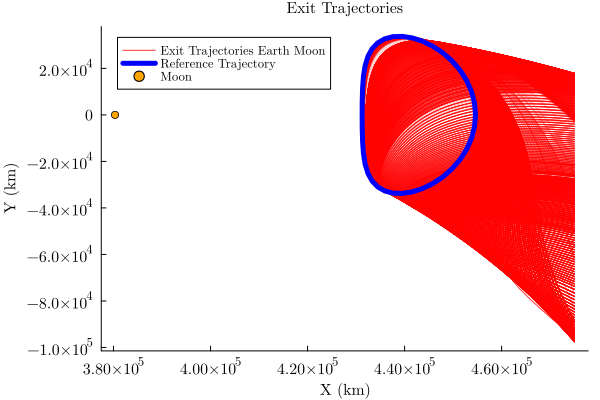

In [14]:
#plot the Earth-Moon Trajectories 

plot(earth_moon_reference[1,:], earth_moon_reference[2,:], label=nothing)

for i=7:4100
    plot!(escape_traj_earth_moon[i][1,:], escape_traj_earth_moon[i][2,:], label=nothing, color=:red, fontfamily="Computer Modern", alpha=0.25) 
end

plot!(escape_traj_earth_moon[1][1,:], escape_traj_earth_moon[1][2,:], label="Exit Trajectories Earth Moon", color=:red, fontfamily="Computer Modern", alpha=0.8) 

plot!(earth_moon_reference[1,:], earth_moon_reference[2,:], label="Reference Trajectory",
 linewidth=5, color=:blue, fontfamily="Computer Modern", xguidefontsize=10, xtickfontsize=10, 
 yguidefontsize=10, ytickfontsize=10)

 title!("Exit Trajectories", fontfamily="Computer Modern", titlefontsize=10) 
 xlabel!("X (km)")
 ylabel!("Y (km)")

 exit_trajectories = scatter!([Earth_Moon.pose_m2[1]*Earth_Moon.position_scale], [0], label = "Moon", color=:orange, fontfamily="Computer Modern", grid=false) 

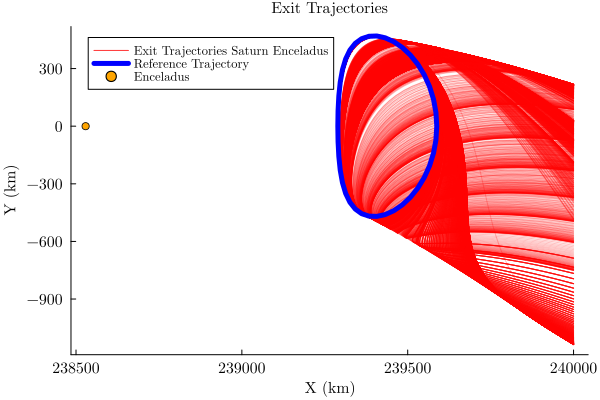

In [20]:
#plot the Saturn-Enceladus Trajectories 

plot(saturn_enceladus_reference[1,:], saturn_enceladus_reference[2,:], label=nothing)

for i=482:4100
    plot!(escape_traj_saturn_enceladus[i][1,:], escape_traj_saturn_enceladus[i][2,:], label=nothing, color=:red, fontfamily="Computer Modern", alpha=0.25) 
end

plot!(escape_traj_saturn_enceladus[1][1,:], escape_traj_saturn_enceladus[1][2,:], label="Exit Trajectories Saturn Enceladus", color=:red, fontfamily="Computer Modern", alpha=0.8) 

plot!(saturn_enceladus_reference[1,:], saturn_enceladus_reference[2,:], label="Reference Trajectory",
 linewidth=5, color=:blue, fontfamily="Computer Modern", xguidefontsize=10, xtickfontsize=10, 
 yguidefontsize=10, ytickfontsize=10)

 title!("Exit Trajectories", fontfamily="Computer Modern", titlefontsize=10) 
 xlabel!("X (km)")
 ylabel!("Y (km)")

 exit_trajectories = scatter!([Saturn_Enceladus.pose_m2[1]*Saturn_Enceladus.position_scale], [0], label = "Enceladus", color=:orange, fontfamily="Computer Modern", grid=false) 